<a href="https://colab.research.google.com/github/esraasayed98/Head-Pose-Estimation/blob/main/HeadPoseEstimation_final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
%%capture
!pip install mediapipe

In [ ]:
import numpy as np
import os,cv2,math,glob,random
import scipy.io as sio
from math import cos, sin
from pathlib import Path
import pandas as pd
import mediapipe
import warnings
warnings.filterwarnings('ignore')
from google.colab.patches import cv2_imshow

# load data

In [ ]:
DATA_PATH="/content/drive/MyDrive/Head_Pose_Estimation/data/AFLW2000-3D.zip"

In [ ]:
# Loading AFLW2000 Data
!unzip /content/drive/MyDrive/Head_Pose_Estimation/data/AFLW2000-3D.zip > /dev/null

# get image names

In [ ]:
images=[Path(f).stem for f in glob.glob('/content/AFLW2000/*.jpg')]
images.sort()
img_ext='.jpg'
annot_ext='.mat'
image_mode='RGB'
len(images)

2000

# Functions

In [ ]:
def draw_axis(img, pitch,yaw,roll, tdx=None, tdy=None, size = 100):

    yaw = -yaw
    if tdx != None and tdy != None:
        tdx = tdx
        tdy = tdy
    else:
        height, width = img.shape[:2]
        tdx = width / 2
        tdy = height / 2

    # X-Axis pointing to right. drawn in red
    x1 = size * (cos(yaw) * cos(roll)) + tdx
    y1 = size * (cos(pitch) * sin(roll) + cos(roll) * sin(pitch) * sin(yaw)) + tdy

    # Y-Axis | drawn in green
    #        v
    x2 = size * (-cos(yaw) * sin(roll)) + tdx
    y2 = size * (cos(pitch) * cos(roll) - sin(pitch) * sin(yaw) * sin(roll)) + tdy

    # Z-Axis (out of the screen) drawn in blue
    x3 = size * (sin(yaw)) + tdx
    y3 = size * (-cos(yaw) * sin(pitch)) + tdy

    cv2.line(img, (int(tdx), int(tdy)), (int(x1),int(y1)),(0,0,255),3)
    cv2.line(img, (int(tdx), int(tdy)), (int(x2),int(y2)),(0,255,0),3)
    cv2.line(img, (int(tdx), int(tdy)), (int(x3),int(y3)),(255,0,0),2)

    return img

In [ ]:
def get_landmarks(image_name, test=False, video=False):
  landmarks_df=pd.DataFrame()
  x_df=pd.DataFrame()
  y_df=pd.DataFrame()

  faceModule = mediapipe.solutions.face_mesh
  # loading image and its correspinding mat file
  with faceModule.FaceMesh(static_image_mode=True) as faces:
      if test==True and video==False:
        image= cv2.imread(image_name)
        
      elif test==False:
        # loading the image
        image = cv2.imread('/content/AFLW2000/'+image_name+'.jpg')
        
      elif test==True and video==True:
        image=image_name
    
      # processing the face to extract the landmark points (468 point) for each x,y,z
      results = faces.process(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
      # print(results.multi_face_landmarks)

      if results.multi_face_landmarks != None: 
      #   # looping over the faces in the image
        for face in results.multi_face_landmarks:
          
            for landmark in face.landmark:
      
              x_df=x_df.append({"image": int(landmark.x * image.shape[1])},ignore_index=True)
              y_df=y_df.append({"image":int(landmark.y * image.shape[0])},ignore_index=True)

  landmarks_df=pd.concat([x_df.T,y_df.T], axis=1)

  return x_df.T,y_df.T,landmarks_df


In [ ]:
def draw_landmarks(image_name):
  landmarks_df=pd.DataFrame()
  faceModule = mediapipe.solutions.face_mesh
  # loading image and its correspinding mat file
  with faceModule.FaceMesh(static_image_mode=True) as faces:
      # loading the image
      image = cv2.imread('/content/AFLW2000/'+image_name+'.jpg')
      # processing the face to extract the landmark points (468 point) for each x,y,z
      results = faces.process(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
      # print(results.multi_face_landmarks)

      if results.multi_face_landmarks != None: 
      #   # looping over the faces in the image
        for face in results.multi_face_landmarks:
          for landmark in face.landmark:
              x = landmark.x
              y = landmark.y
              # note: the x and y values are scaled to the their width and height so we will get back their actual value in the image
              shape = image.shape 
              relative_x = int(x * shape[1])
              relative_y = int(y * shape[0])
              # cv2.putText(image, str(relative_y), (int(relative_x),int(relative_y)), cv2.FONT_HERSHEY_SIMPLEX, 0.4, (0,255,0), 2)
              cv2.circle(image, (relative_x, relative_y), radius=1, color=(0, 255, 0), thickness=2)
      cv2_imshow(image)

In [ ]:
def get_ypr_from_mat(mat_path):
    # Get yaw, pitch, roll from .mat annotation.
    # They are in radians
    mat = sio.loadmat(mat_path)
    # [pitch yaw roll tdx tdy tdz scale_factor]
    pre_pose_params = mat['Pose_Para'][0]
    # Get [pitch, yaw, roll]
    pose_params = pre_pose_params[:3]
    return pose_params

# Test on image

In [ ]:
# choosing random image
random_file = 'image00004'
x_points_df, y_points_df, point_landmarks=get_landmarks(random_file )

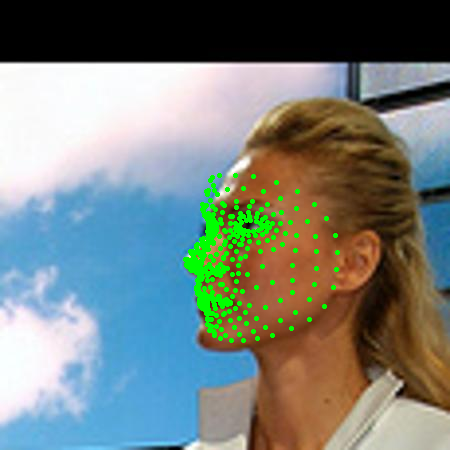

In [ ]:
draw_landmarks(random_file)

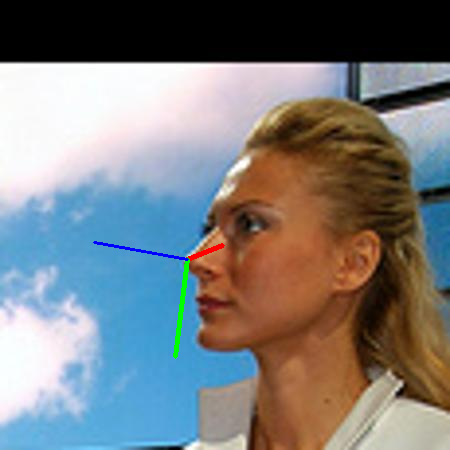

In [ ]:
image = cv2.imread('/content/AFLW2000/'+random_file+'.jpg')
# loading the mat file to extract the 3 angels of the face (pitch,yaw,roll)
mat_file = sio.loadmat('/content/AFLW2000/'+random_file+'.mat')
# extracting the labels 3 angels
pose_para = mat_file["Pose_Para"][0][:3]
pitch = pose_para[0]
yaw = pose_para[1]
roll = pose_para[2]
cv2_imshow(draw_axis(image,pitch,yaw,roll,tdx=x_points_df[4][0],tdy=y_points_df[4][0]))

# loop through all images to get the landmark of each image

In [ ]:
#loop through all images

data_landmarks=pd.DataFrame()
wrong_images=[]

for i,img in enumerate(images):
  
  x,y,image_df=get_landmarks(img)
 
  if x.shape==(0,0):
    wrong_images.append(img)

  else:  

    data_landmarks=pd.concat([data_landmarks, image_df],    # Combine vertically
                          ignore_index = True,)
    print(data_landmarks.shape)
    

(1, 936)
(2, 936)
(3, 936)
(4, 936)
(5, 936)
(6, 936)
(7, 936)
(8, 936)
(9, 936)
(10, 936)
(11, 936)
(12, 936)
(13, 936)
(14, 936)
(15, 936)
(16, 936)
(17, 936)
(18, 936)
(19, 936)
(20, 936)
(21, 936)
(22, 936)
(23, 936)
(24, 936)
(25, 936)
(26, 936)
(27, 936)
(28, 936)
(29, 936)
(30, 936)
(31, 936)
(32, 936)
(33, 936)
(34, 936)
(35, 936)
(36, 936)
(37, 936)
(38, 936)
(39, 936)
(40, 936)
(41, 936)
(42, 936)
(43, 936)
(44, 936)
(45, 936)
(46, 936)
(47, 936)
(48, 936)
(49, 936)
(50, 936)
(51, 936)
(52, 936)
(53, 936)
(54, 936)
(55, 936)
(56, 936)
(57, 936)
(58, 936)
(59, 936)
(60, 936)
(61, 936)
(62, 936)
(63, 936)
(64, 936)
(65, 936)
(66, 936)
(67, 936)
(68, 936)
(69, 936)
(70, 936)
(71, 936)
(72, 936)
(73, 936)
(74, 936)
(75, 936)
(76, 936)
(77, 936)
(78, 936)
(79, 936)
(80, 936)
(81, 936)
(82, 936)
(83, 936)
(84, 936)
(85, 936)
(86, 936)
(87, 936)
(88, 936)
(89, 936)
(90, 936)
(91, 936)
(92, 936)
(93, 936)
(94, 936)
(95, 936)
(96, 936)
(97, 936)
(98, 936)
(99, 936)
(100, 936)
(101, 93

# get labels

In [ ]:
labels_df=pd.DataFrame()

for img in images:
  if img not in wrong_images:
    mat_path = os.path.join('/content/AFLW2000/',img + annot_ext)
    # We get the pose in radians
    pose = get_ypr_from_mat(mat_path)
    # And convert to degrees.
    pitch = pose[0] * 180 / np.pi
    yaw = pose[1] * 180 / np.pi
    roll = pose[2] * 180 / np.pi
    # Bin values
    bins = np.array(range(-99, 102, 3))
    labels =np.digitize([yaw, pitch, roll], bins) - 1
    cont_labels = [yaw, pitch, roll]
    labels_df=labels_df.append({"Yaw":cont_labels[0], "pitch":cont_labels[1],"roll": cont_labels[2]},ignore_index=True  )
    

In [ ]:
labels_df.head()

,Yaw,pitch,roll
0,1.044306,-22.874239,4.908886
1,68.155241,26.932742,17.243670
2,50.485412,-10.579652,-13.570645
3,17.143374,-10.048456,-21.392783
4,0.685565,-1.536199,-12.643008


In [ ]:
labels_df.shape

(1853, 3)

# combine the 2 dataframes

In [ ]:
# combine 2 dataframes

data=pd.concat([data_landmarks, labels_df], axis=1)
data.shape

(1853, 939)

In [ ]:
data.head()

,0,1,2,3,4,5,6,7,8,9,...,461,462,463,464,465,466,467,Yaw,pitch,roll
0,218.0,220.0,220.0,215.0,220.0,222.0,226.0,163.0,228.0,229.0,...,289.0,290.0,218.0,221.0,225.0,212.0,208.0,1.044306,-22.874239,4.908886
1,198.0,187.0,201.0,196.0,187.0,192.0,208.0,208.0,213.0,212.0,...,270.0,272.0,228.0,230.0,231.0,225.0,222.0,68.155241,26.932742,17.243670
2,143.0,144.0,143.0,139.0,144.0,144.0,142.0,111.0,141.0,141.0,...,350.0,350.0,323.0,324.0,325.0,320.0,319.0,50.485412,-10.579652,-13.570645
3,226.0,211.0,220.0,199.0,207.0,205.0,203.0,162.0,196.0,192.0,...,293.0,293.0,225.0,229.0,233.0,205.0,200.0,17.143374,-10.048456,-21.392783
4,229.0,221.0,224.0,210.0,219.0,217.0,213.0,161.0,210.0,208.0,...,274.0,276.0,216.0,219.0,221.0,203.0,201.0,0.685565,-1.536199,-12.643008


In [ ]:
data.to_csv("/content/drive/MyDrive/Head_Pose_Estimation/data/data_landmarks.csv",index=False) #save to file


-------

# Read data


In [ ]:
data=pd.read_csv("/content/drive/MyDrive/Head_Pose_Estimation/data/data_landmarks.csv")

In [ ]:
data.head()

,0,1,2,3,4,5,6,7,8,9,...,461.1,462.1,463.1,464.1,465.1,466.1,467.1,Yaw,pitch,roll
0,218.0,220.0,220.0,215.0,220.0,222.0,226.0,163.0,228.0,229.0,...,289.0,290.0,218.0,221.0,225.0,212.0,208.0,1.044306,-22.874239,4.908886
1,198.0,187.0,201.0,196.0,187.0,192.0,208.0,208.0,213.0,212.0,...,270.0,272.0,228.0,230.0,231.0,225.0,222.0,68.155241,26.932742,17.243670
2,143.0,144.0,143.0,139.0,144.0,144.0,142.0,111.0,141.0,141.0,...,350.0,350.0,323.0,324.0,325.0,320.0,319.0,50.485412,-10.579652,-13.570645
3,226.0,211.0,220.0,199.0,207.0,205.0,203.0,162.0,196.0,192.0,...,293.0,293.0,225.0,229.0,233.0,205.0,200.0,17.143374,-10.048456,-21.392783
4,229.0,221.0,224.0,210.0,219.0,217.0,213.0,161.0,210.0,208.0,...,274.0,276.0,216.0,219.0,221.0,203.0,201.0,0.685565,-1.536199,-12.643008


In [ ]:
data.shape

(1853, 939)

# Train_Test_split

In [ ]:
y=data[['Yaw','pitch','roll']]
X=data.drop(columns=['Yaw','pitch','roll'],axis=1)

In [ ]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.2,random_state=42)

# Construct Model

In [ ]:
from sklearn.multioutput import MultiOutputRegressor
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor
import xgboost as xgb
from sklearn.model_selection import cross_val_score

In [ ]:
# RandomForest
RF_reg = MultiOutputRegressor(RandomForestRegressor())
#train
RF_reg.fit(X_train, y_train)
#predict
predictions=RF_reg.predict(X_test)
RF_reg.score(X_test, y_test, sample_weight=None)

0.684628330748073

In [ ]:
# SVR
svr_reg = MultiOutputRegressor(SVR(), n_jobs=2)

#train
svr_reg.fit(X_train, y_train)
#predict
predictions=svr_reg.predict(X_test)

svr_reg.score(X_test, y_test, sample_weight=None)

0.6920061148651486

# Demo on test image

In [ ]:
# choosing random image
test_image = "/content/drive/MyDrive/Head_Pose_Estimation/data/image2.jpg"
x_points_df, y_points_df, point_landmarks=get_landmarks(test_image, test=True)

In [ ]:
point_landmarks.shape

(1, 936)

In [ ]:
landmarks_points=np.array(point_landmarks)

In [ ]:

predict =svr_reg.predict(landmarks_points.reshape(1, -1))
predict

array([[-4.9099693 , -8.99273215, -2.19395849]])

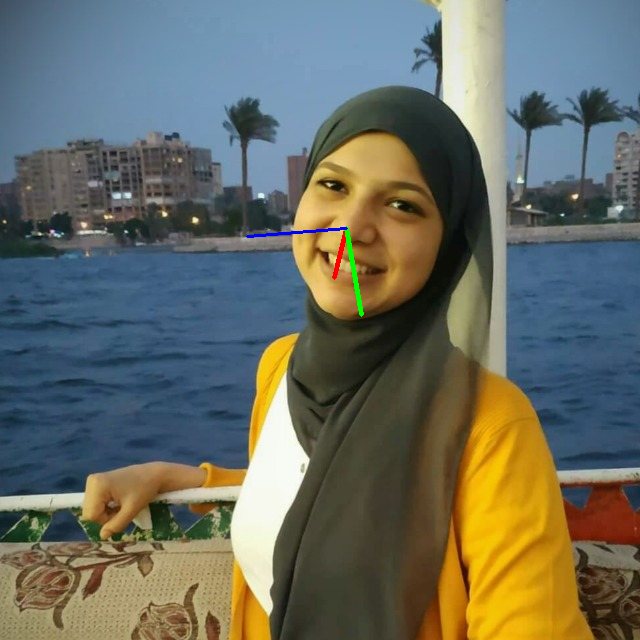

In [ ]:
## draw
image = cv2.imread("/content/drive/MyDrive/Head_Pose_Estimation/data/image2.jpg")

cv2_imshow(draw_axis(image,predict[0][1],predict[0][0],predict[0][2],tdx=x_points_df[4][0],tdy=y_points_df[4][0]))

# Demo on video

In [ ]:
VIDEO_PATH_1="/content/drive/MyDrive/Head_Pose_Estimation/data/test video/v1.mp4"
VIDEO_PATH_2="/content/drive/MyDrive/Head_Pose_Estimation/data/test video/v7.mp4"

In [ ]:
cap = cv2.VideoCapture(VIDEO_PATH_2)

if (cap.isOpened()== False): 
  print("Error opening video  file")

# number of frames
int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

355

In [ ]:
faceModule = mediapipe.solutions.face_mesh

faces = faceModule.FaceMesh(static_image_mode=True)

In [ ]:
#set first dimension as number of frames
test_Data = np.zeros((355,936))
data_point = 0
feature = 0

In [ ]:
cap = cv2.VideoCapture(VIDEO_PATH_2)

if (cap.isOpened()== False): 
  print("Error opening video  file")

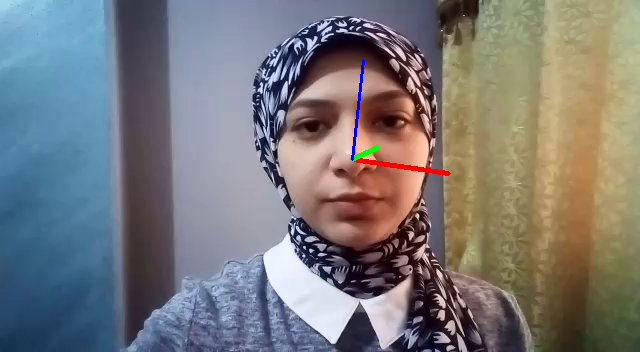

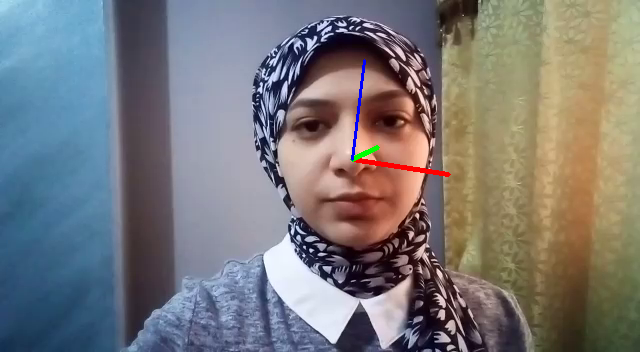

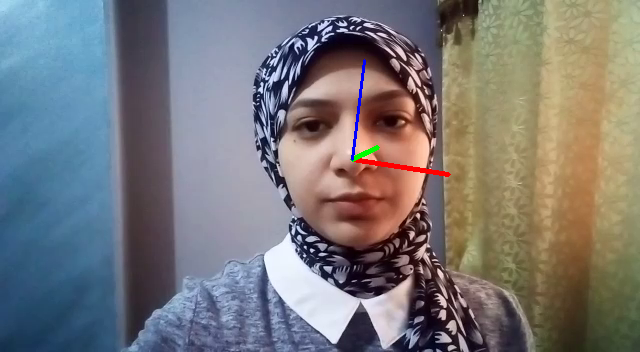

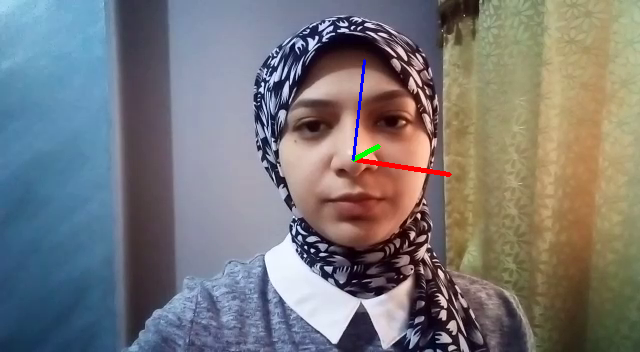

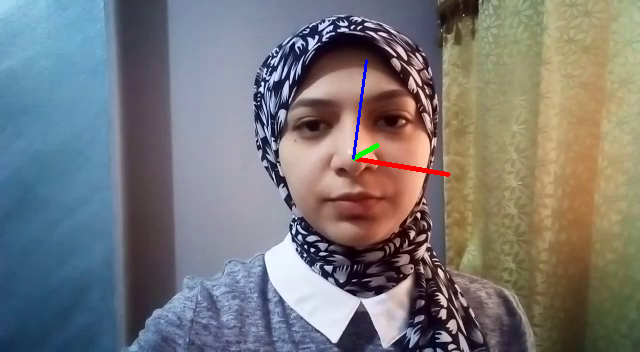

...

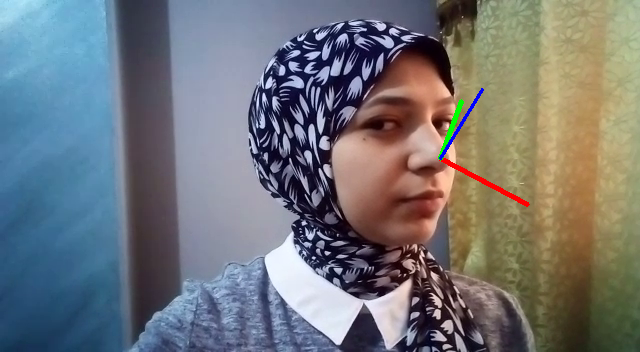

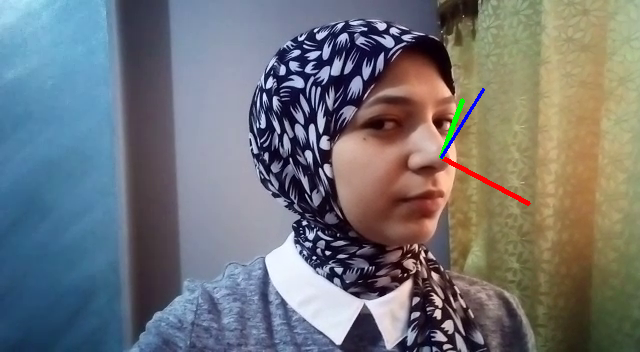

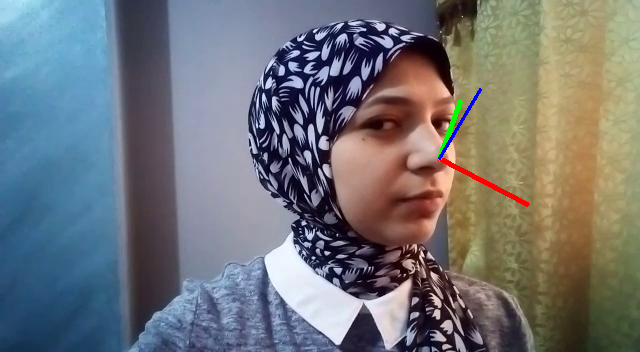

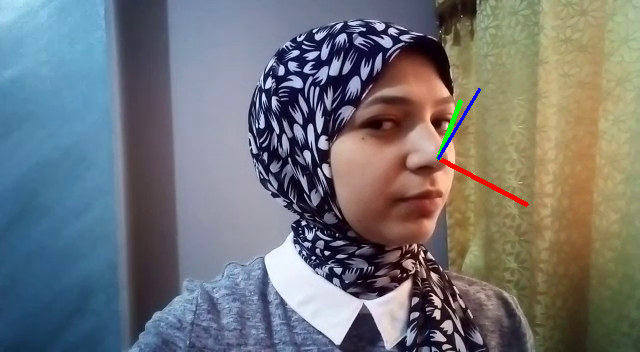

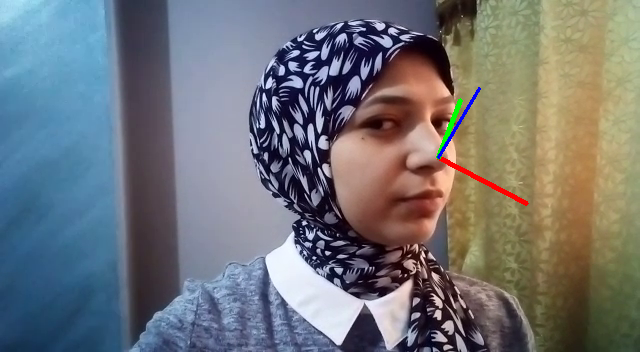

In [ ]:
img_array = []
test_image = 0
while(cap.isOpened()):
    ret, frame = cap.read()
    if ret == True:
      x_points_df, y_points_df, point_landmarks=get_landmarks(frame, test=True, video=True)
      landmarks_points=np.array(point_landmarks)
      predict =svr_reg.predict(landmarks_points.reshape(1, -1))
      frame=draw_axis(frame,predict[0][1],predict[0][0],predict[0][2],tdx=x_points_df[4][0],tdy=y_points_df[4][0])
      cv2_imshow(frame)
      img_array.append(frame)
      height, width, layers = frame.shape
      size  = (width,height)
      test_image = test_image + 1
    else:
      break

out = cv2.VideoWriter('output_video.mp4',cv2.VideoWriter_fourcc(*'DIVX'), 15, size)
 
for i in range(len(img_array)):
    out.write(img_array[i])
    print(i)
out.release()

In [ ]:
cap.release()
cv2.destroyAllWindows()
test_Data.shape

(355, 936)